Device to CUDA or MPS

In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.image import imsave
import torchvision.transforms as transforms
import random
try:
    from einops import rearrange
except ImportError:
    %pip install einops
    from einops import rearrange

from sklearn import preprocessing
import warnings
warnings.filterwarnings("ignore")

%matplotlib inline
%config InlineBackend.figure_format = "retina"

if torch.backends.mps.is_available():
    device = torch.device("mps")
elif torch.cuda.is_available():
    device = torch.device("cuda")
else:
    device = torch.device("cpu")

print(device)

cpu


In [3]:
!wget https://segment-anything.com/assets/gallery/AdobeStock_94274587_welsh_corgi_pembroke_CD.jpg -O dog.jpg


'wget' is not recognized as an internal or external command,
operable program or batch file.


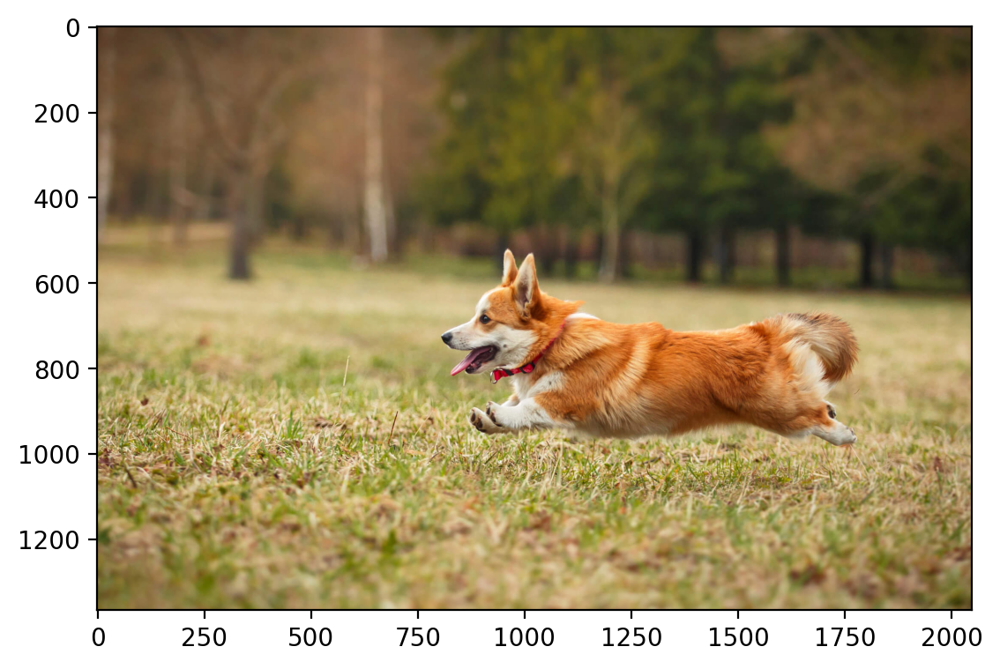

In [4]:
# latexify(columns = 2, fig_width = 8)
img = torchvision.io.read_image('dog.jpg')
plt.imshow(rearrange(img, "c h w -> h w c").numpy())
plt.show()

In [5]:
img = torchvision.transforms.functional.crop(img.cpu(), 600, 800, 300, 300)
print(img.shape)

torch.Size([3, 300, 300])


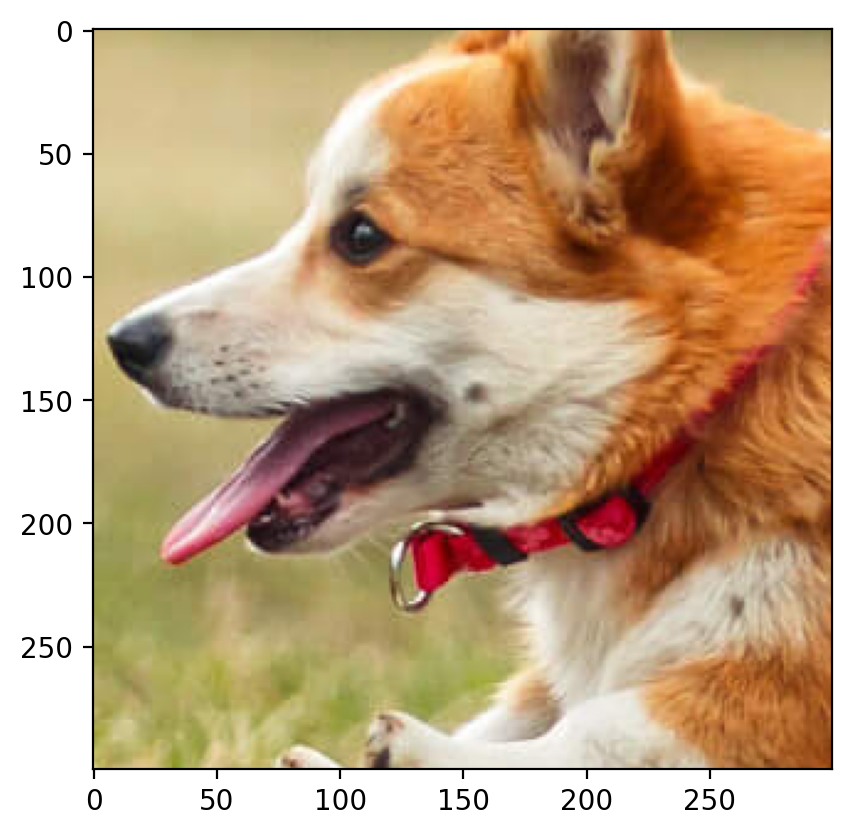

In [6]:
# latexify(columns = 2, fig_width = 8)
plt.imshow(rearrange(img, "c h w -> h w c").numpy())
plt.show()

In [7]:
scaler_img = preprocessing.MinMaxScaler().fit(img.reshape(-1, 1))
img_scaled = scaler_img.transform(img.reshape(-1, 1)).reshape(img.shape)
img_scaled.shape
img_scaled = torch.tensor(img_scaled)
img_scaled = img_scaled.to(device, dtype = torch.float32)
img_scaled

tensor([[[0.7686, 0.7686, 0.7686,  ..., 0.5451, 0.5451, 0.5412],
         [0.7725, 0.7725, 0.7725,  ..., 0.5686, 0.5686, 0.5647],
         [0.7765, 0.7765, 0.7765,  ..., 0.5882, 0.5843, 0.5843],
         ...,
         [0.7961, 0.7373, 0.7176,  ..., 0.5843, 0.5725, 0.5490],
         [0.8471, 0.7843, 0.7451,  ..., 0.6039, 0.5686, 0.5569],
         [0.8784, 0.8196, 0.7686,  ..., 0.6275, 0.5804, 0.5686]],

        [[0.6941, 0.6941, 0.6941,  ..., 0.5137, 0.5137, 0.5098],
         [0.6980, 0.6980, 0.6980,  ..., 0.5255, 0.5255, 0.5216],
         [0.7020, 0.7020, 0.7020,  ..., 0.5451, 0.5412, 0.5412],
         ...,
         [0.7686, 0.7098, 0.6863,  ..., 0.2824, 0.2706, 0.2431],
         [0.8157, 0.7569, 0.7137,  ..., 0.3059, 0.2667, 0.2431],
         [0.8431, 0.7882, 0.7333,  ..., 0.3294, 0.2706, 0.2588]],

        [[0.4745, 0.4745, 0.4745,  ..., 0.3294, 0.3294, 0.3255],
         [0.4784, 0.4784, 0.4784,  ..., 0.3451, 0.3451, 0.3412],
         [0.4824, 0.4824, 0.4824,  ..., 0.3647, 0.3608, 0.

$ \text{PSNR} = 20 \log_{10}(\frac{\text{MAX}_I}{\sqrt{\text{MSE}}})$

In [8]:
def metrics(img1, img2, max_value = 1.0):
    rmse = torch.sqrt(F.mse_loss(img1, img2))
    psnr_value = 20 * torch.log10(max_value / rmse)
    return rmse, psnr_value.item()

In [9]:
def remove_patch(img, Corner, d, display = True):
    X, Y = Corner
    img_copy = img.clone()
    img_copy[:, X : X + d, Y : Y + d] = float("nan")
    crop = transforms.functional.crop(img.cpu(), X, Y, d, d)
    fig, ax = plt.subplots(nrows = 1, ncols = 2, gridspec_kw = {"width_ratios": [img.shape[2] / (5 * d), 1]})
    fig.suptitle(fr"Patch size = $({d} \times {d})$ removed", fontsize = 16)
    ax[0].imshow(rearrange(img_copy, 'c h w -> h w c').cpu().numpy())
    ax[0].set_title("Masked Image")
    ax[1].imshow(rearrange(crop, 'c h w -> h w c').cpu().numpy())
    ax[1].set_title("Masked Crop")
    if (display):
        plt.show()
    else:
        plt.close()
    return img_copy, crop

In [10]:
def remove_subset(img, d, display = True):
    img_copy = img.clone()
    height, width = img.shape[1], img.shape[2]
    random_h_coords = random.sample(range(height), d)
    random_w_coords = random.sample(range(width), d)
    img_copy[:, random_h_coords, random_w_coords] = float("nan")
    plt.title(fr"Random {d*d} points removed from image", fontsize = 16)
    plt.imshow(rearrange(img_copy, 'c h w -> h w c').cpu().numpy())
    if (display):
        plt.show()
    else:
        plt.close()
    return img_copy

Alternating Least Squares $X_{N \times d} \approx U_{N \times k} V_{k \times d}$

In [11]:
def factorize(Img, k=2, epochs=1000, convergence=1e-6, device = torch.device("cpu")):
    """
    Implements Alternative Least Squares Algorithm for Matrix Factorization X = UV
    Inputs:
    X: Ground Truth Matrix of size (Nxd)
    k: Rank
    epochs: Number of epochs t=for convergence
    convergence: Threshold value of change of losses in consecutive epochs.
    mask: Whether a mask needs to be applied on the image (for the case of incomplete matrix)

    Outputs:
    U: Matrix of size (Nxk)
    V: Matrix of size (kxd)
     """
    Img = Img.to(device)
    Us, Vs, losses, images = [], [], [], []
    for channel in range(Img.shape[0]):
        X = Img[channel]

        torch.manual_seed(1)
        N,d  = X.shape[0], X.shape[1]
        U = torch.randn(N, k, requires_grad = False, device = device)
        V = torch.randn(k, d, requires_grad = False, device = device)

        mask = ~torch.isnan(X) # True for all relevant values
        prev_loss = float('inf')
        for i in range(epochs):
            for col in range(d):
                x = X[mask[:,col],col]
                u = U[mask[:,col],:]
                V[:,col] = torch.linalg.lstsq(u,x,rcond=None)[0]

            for row in range(N):
                x = X[row,mask[row,:]]
                v = V.T[mask[row,:],:]
                U[row,:] = torch.linalg.lstsq(v,x,rcond=None)[0]

            diff_matrix = torch.mm(U, V) - X
            diff_vector = diff_matrix[mask]
            loss = torch.norm(diff_vector)

            if torch.abs(prev_loss - loss) < convergence:
                break
            prev_loss = loss.item()

        Us.append(U)
        Vs.append(V)
        losses.append(loss)
        images.append(torch.mm(U, V))

    return Us, Vs, losses, torch.stack([images[0], images[1], images[2]], dim = 0), i

In [12]:
def train_reconstruct_plot_patch(img, Corner, d, features, convergence, device, allowMetrics = False, epochs = 1000):
  imgSingle, croppedSingle = remove_patch(img, Corner, d, display = False)
  Us, Vs, losses, FinalImage, i = factorize(imgSingle, k = features, epochs=epochs, convergence=convergence, device=device)
  img_copy = FinalImage.clone()
  X, Y = Corner
  newCroppedSingle = img_copy[:, X : X + d, Y : Y + d]
  rmse, psnr = metrics(img, img_copy)
  fig, ax = plt.subplots(nrows = 1, ncols = 3, gridspec_kw = {"width_ratios": [img.shape[2] / (3 * d), 1, img.shape[2] / (3 * d)]}, figsize = (15, 8))
  fig.suptitle(f"Alternating Least Squares | RMSE : {rmse} | PNSR : {psnr}" "\n" fr"Crop Corner = $({X}, {Y})$" "\n" f"Features = {features}" "\n" fr"Loss Red = {losses[0]}, Loss Green = {losses[0]}, Loss Blue = {losses[2]}" "\n" f"Converged after {i} iteration", fontsize = 12)
  ax[0].imshow(rearrange(imgSingle, 'c h w -> h w c').cpu().numpy())
  ax[0].set_title("Masked Image" "\n" rf"$({img.shape[1]} \times {img.shape[2]})$")
  ax[1].imshow(rearrange(croppedSingle, 'c h w -> h w c').cpu().numpy())
  ax[1].set_title("Patch" "\n" fr"$({d} \times {d})$")
  ax[2].imshow(rearrange(FinalImage, 'c h w -> h w c').cpu().detach().numpy())
  ax[2].set_title("Reconstructed Image" "\n" rf"$({img.shape[1]} \times {img.shape[2]})$")
  for i in range(3):
      ax[i].axis("off")
  plt.show()

  fig, ax = plt.subplots(nrows = 1, ncols = 2, gridspec_kw = {"width_ratios": [1, 1]}, figsize = (8, 4))
  fig.suptitle("Alternating Least Squares | Comparison of Original and Reconstructed Patch", fontsize = 12)
  ax[0].imshow(rearrange(croppedSingle, 'c h w -> h w c').cpu().numpy())
  ax[0].set_title("Original Patch")
  ax[0].axis("off")
  ax[1].imshow(rearrange(newCroppedSingle, 'c h w -> h w c').cpu().detach().numpy())
  ax[1].set_title("Reconstructed Patch")
  ax[1].axis("off")
  plt.show()

  if (allowMetrics):
      return rmse, psnr

In [13]:
def train_reconstruct_plot_subset(img, d, features, convergence, device,  allowMetrics = False, epochs = 1000):
  imgSingle = remove_subset(img, d, display = False)
  Us, Vs, losses, FinalImage, i = factorize(imgSingle, k = features, convergence = convergence, device = device, epochs = epochs)
  img_copy = FinalImage.clone()
  rmse, psnr = metrics(img, img_copy)
  fig, ax = plt.subplots(nrows = 1, ncols = 2, gridspec_kw = {"width_ratios": [1, 1]}, figsize = (10, 6))
  fig.suptitle(f"Alternating Least Squares | RMSE : {rmse} | PNSR : {psnr}" "\n" f"Features = {features}" "\n" fr"Loss Red = {losses[0]}, Loss Green = {losses[0]}, Loss Blue = {losses[2]}" "\n" f"Converged after {i} iteration", fontsize = 12)
  ax[0].imshow(rearrange(imgSingle, 'c h w -> h w c').cpu().numpy())
  ax[0].set_title("Masked Image")
  ax[0].axis("off")
  ax[1].imshow(rearrange(FinalImage, 'c h w -> h w c').cpu().detach().numpy())
  ax[1].set_title("Reconstructed Image")
  ax[1].axis("off")
  plt.show()

  if (allowMetrics):
      return rmse, psnr

30 x 30 Rectangular Patch Removed

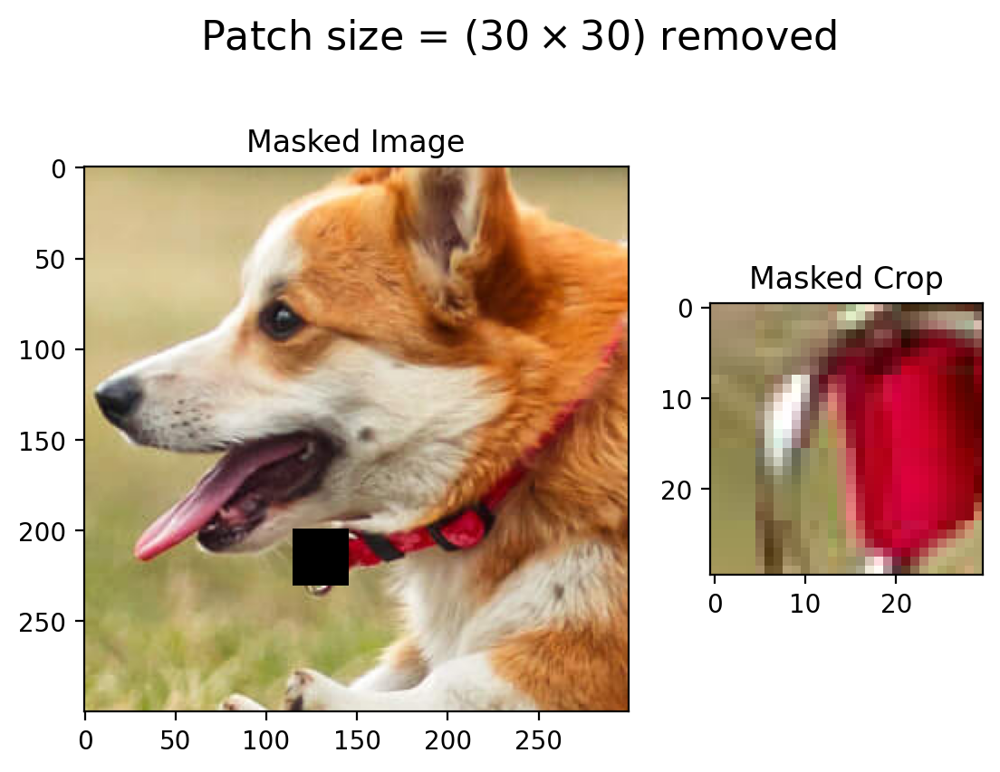

In [ ]:
imgSingle30, croppedSingle30 = remove_patch(img_scaled, (200, 115), 30)

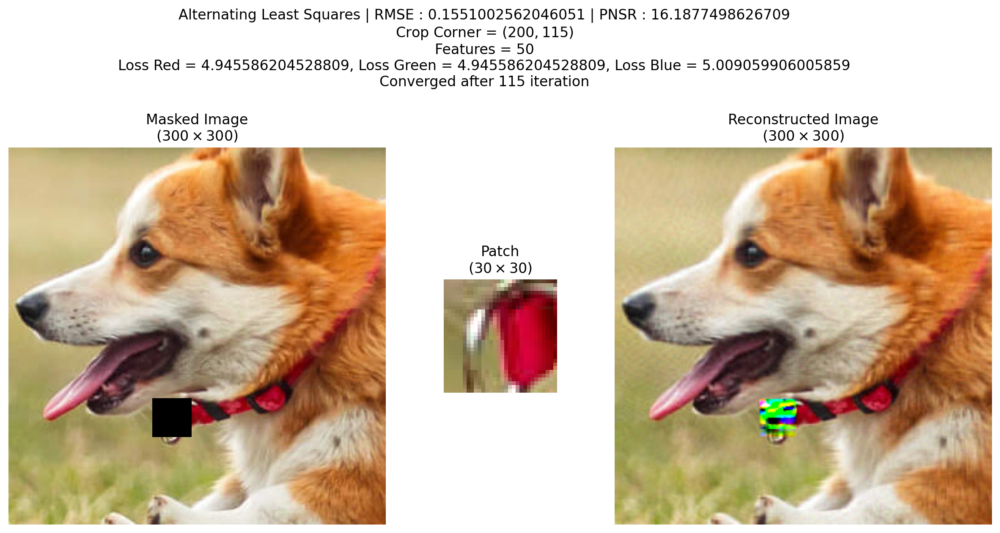

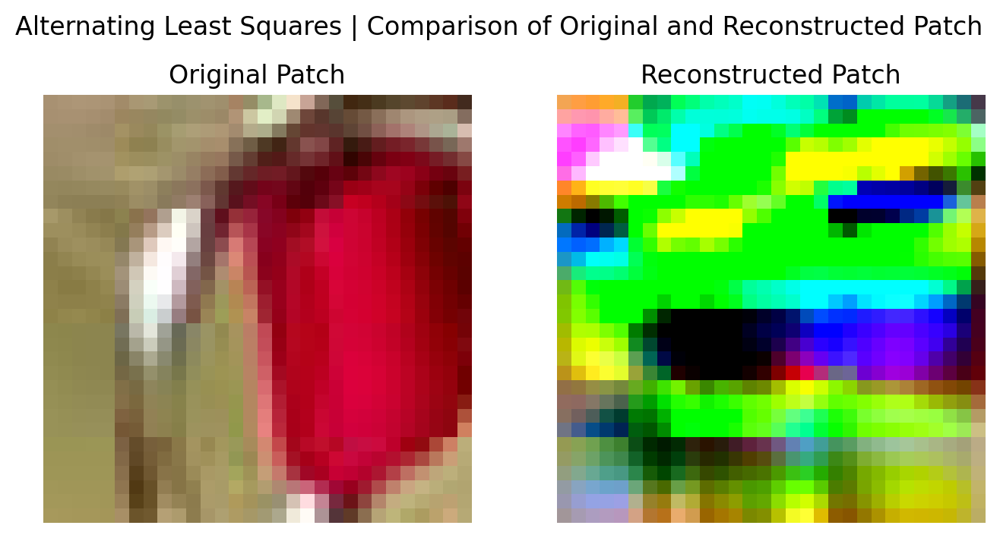

In [ ]:
features = 50
train_reconstruct_plot_patch(img_scaled, (200, 115), 30, features, 1e-5, device, epochs = 1000)

Uniformly chosen 900 (30 x 30) Points Missing

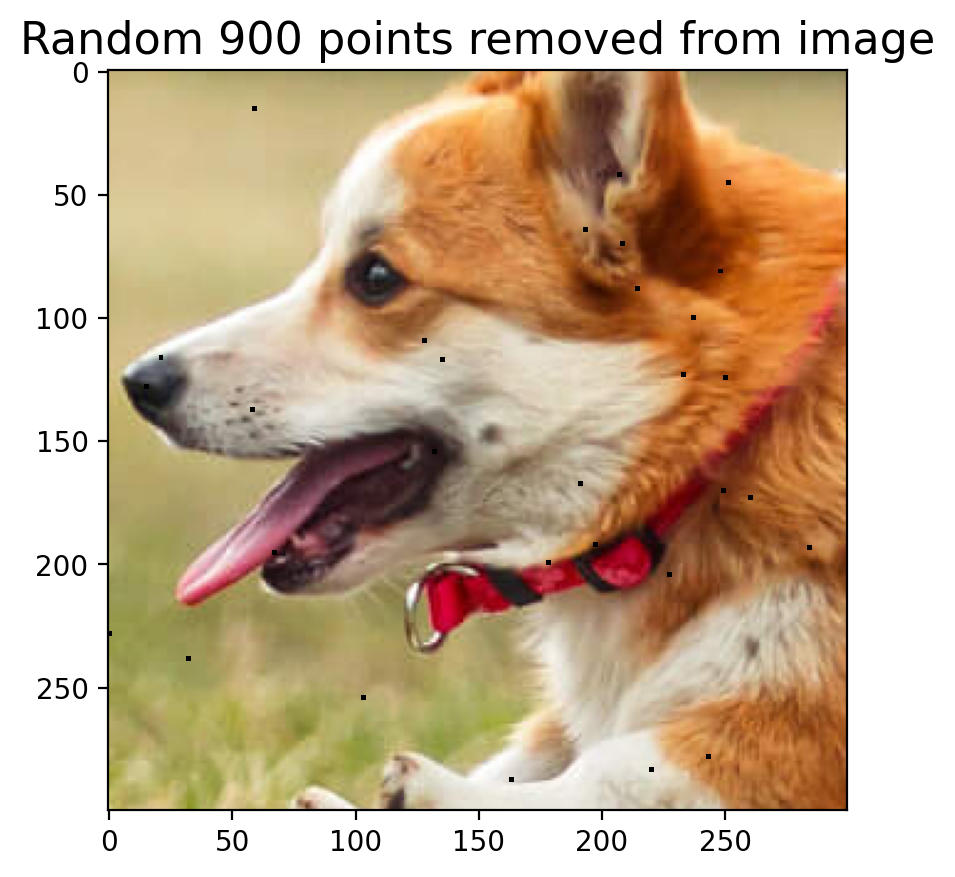

In [ ]:
imgSingle900 = remove_subset(img_scaled, 30, display = True)

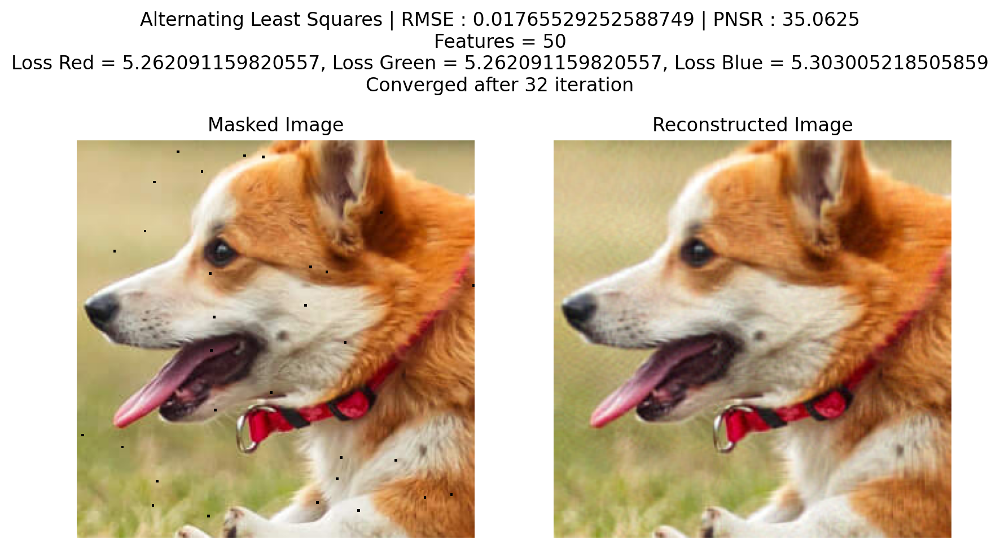

In [ ]:
features = 50
train_reconstruct_plot_subset(img_scaled, 30, features, 1e-6, device, epochs = 1000)

Varying Removed Patch Size  

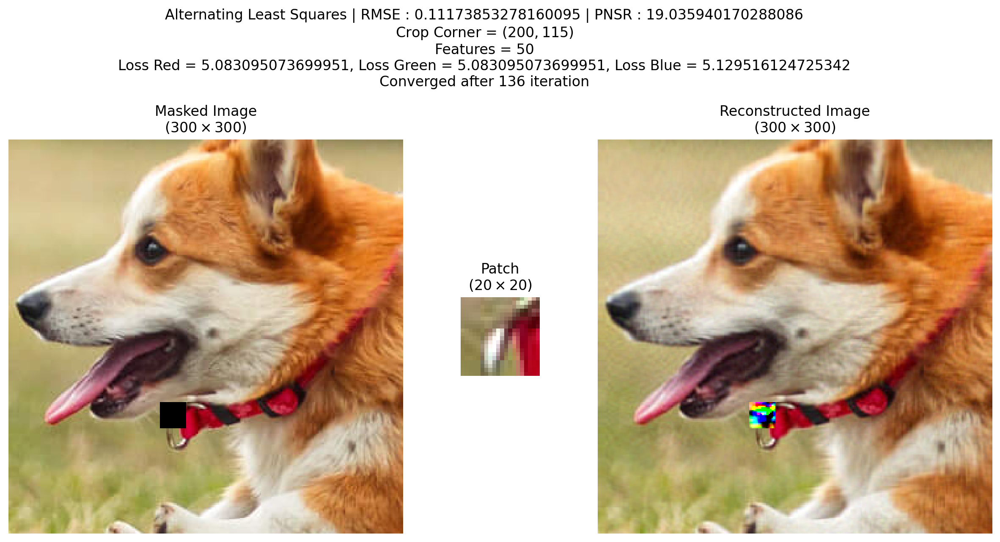

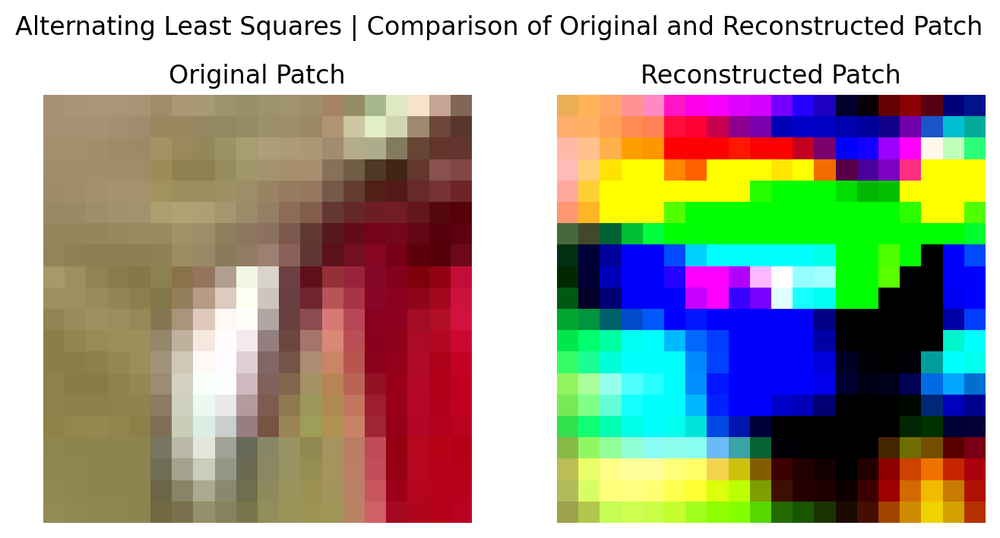

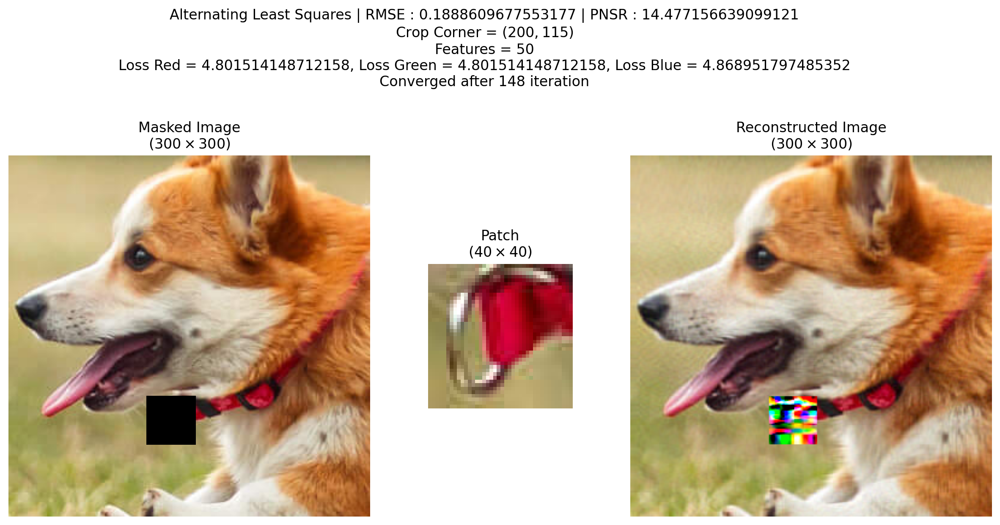

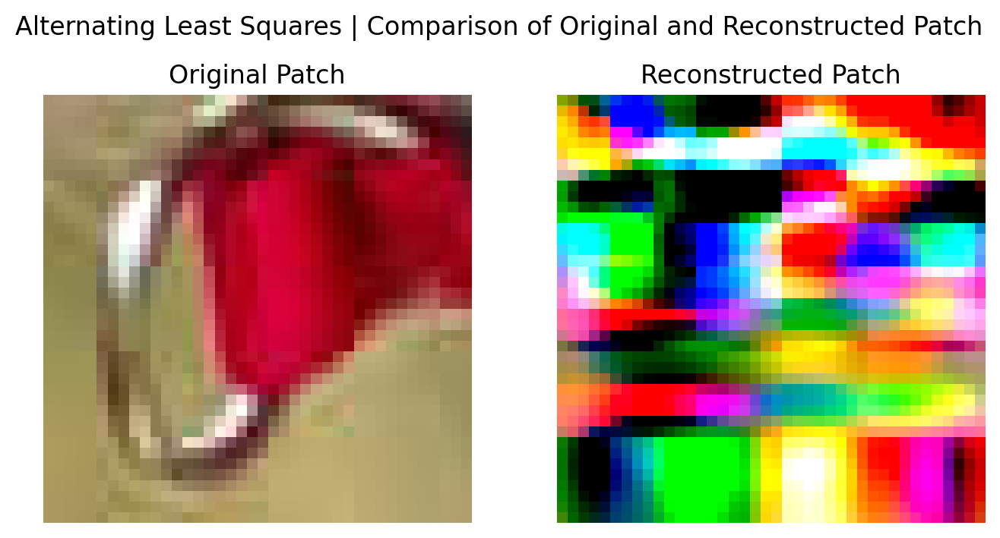

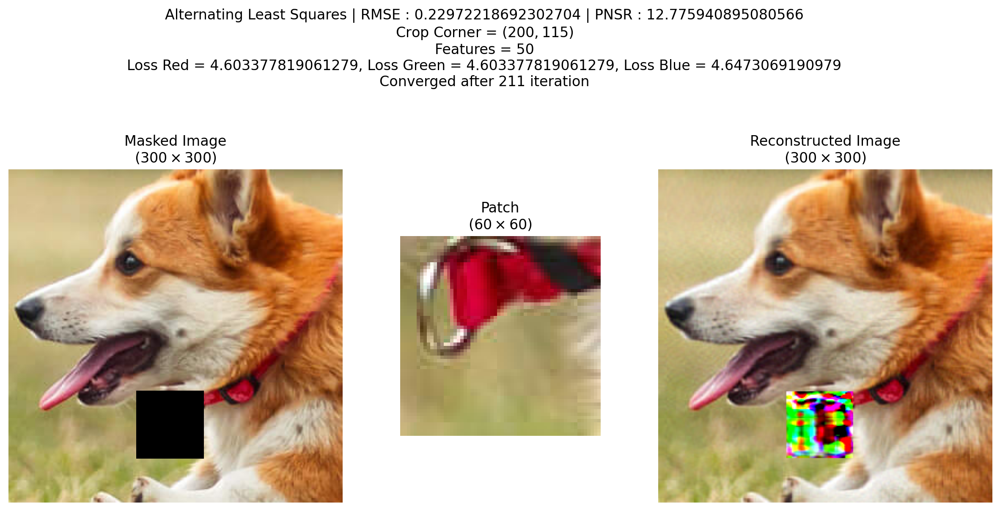

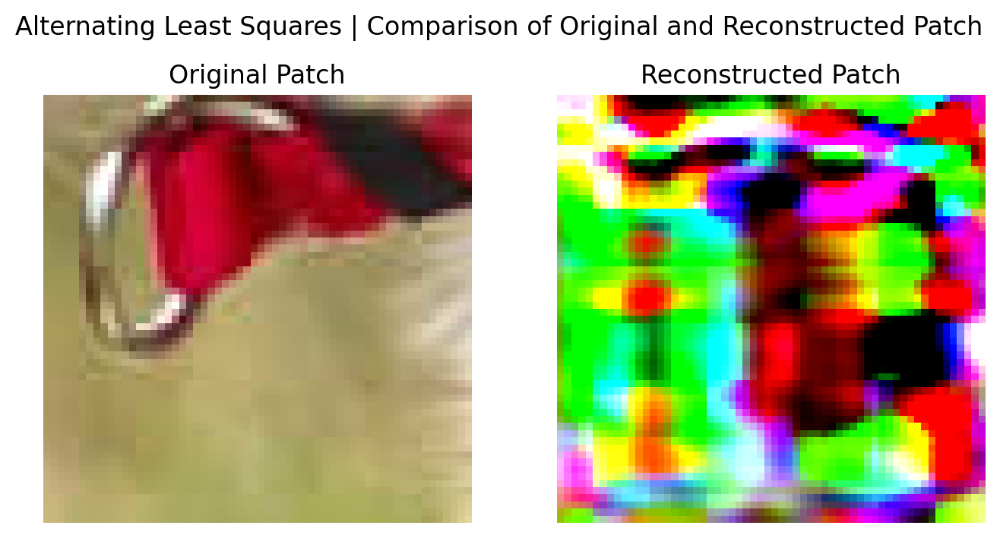

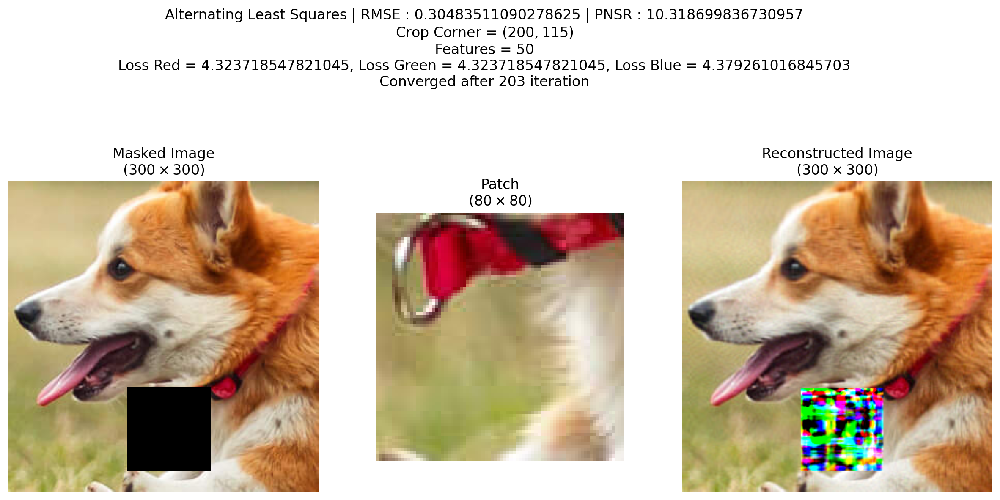

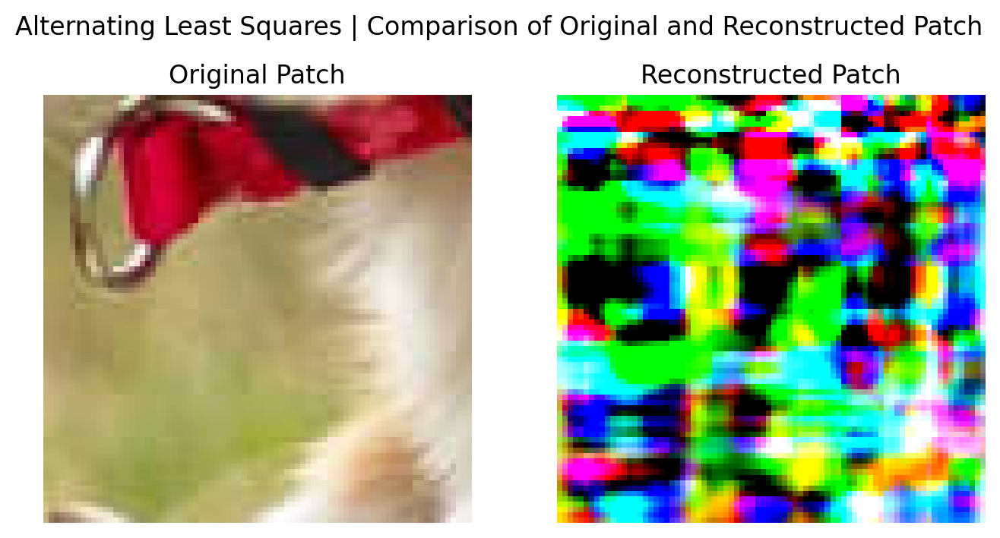

In [ ]:
features = 50
rmses, psnrs = [], []
patches = [20, 40, 60, 80]
for i, patch_size in enumerate(patches):
    rmse, psnr = train_reconstruct_plot_patch(img_scaled, (200, 115), d = patch_size, features = features, convergence = 1e-5, device=device, allowMetrics = True)
    rmses.append(rmse)
    psnrs.append(psnr)

Varying number of random pixels removed

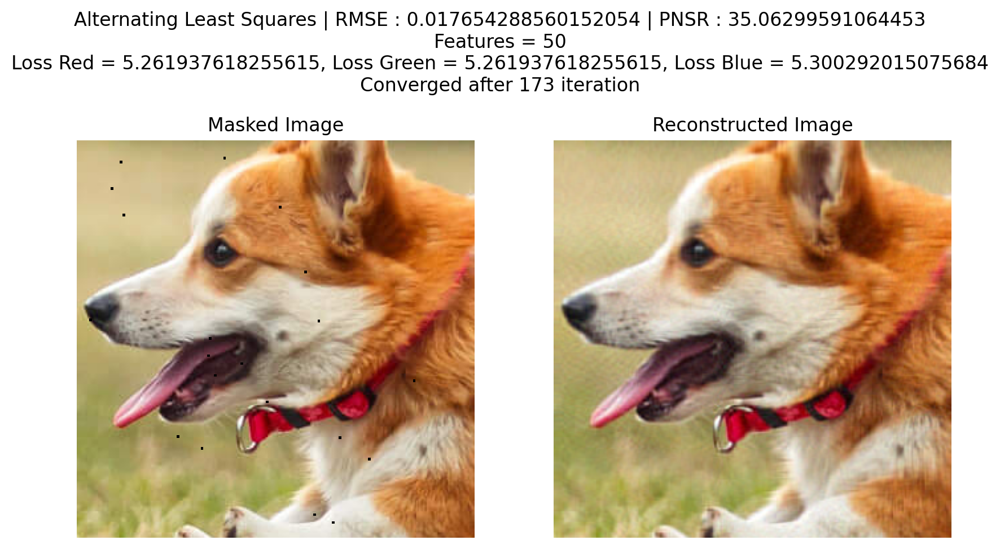

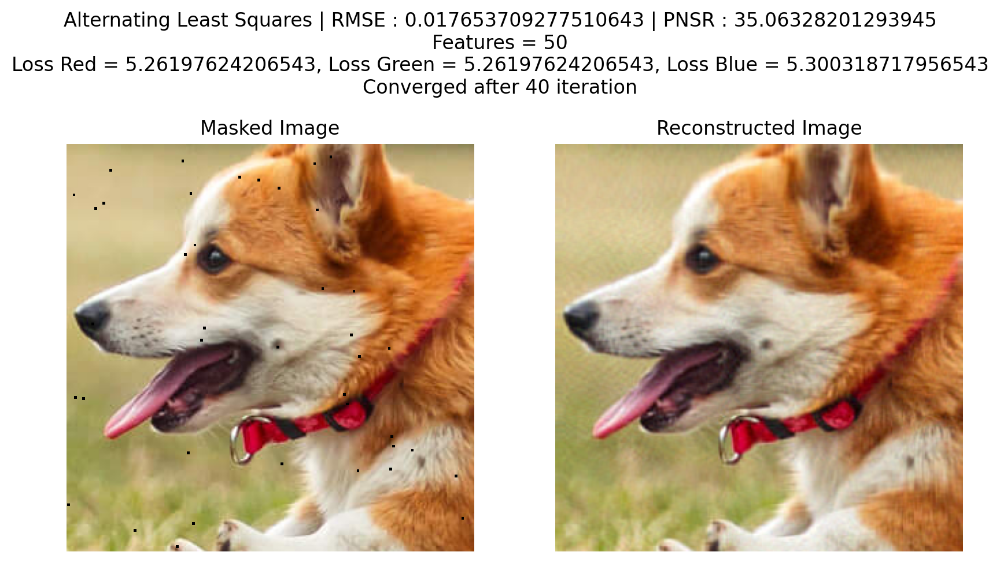

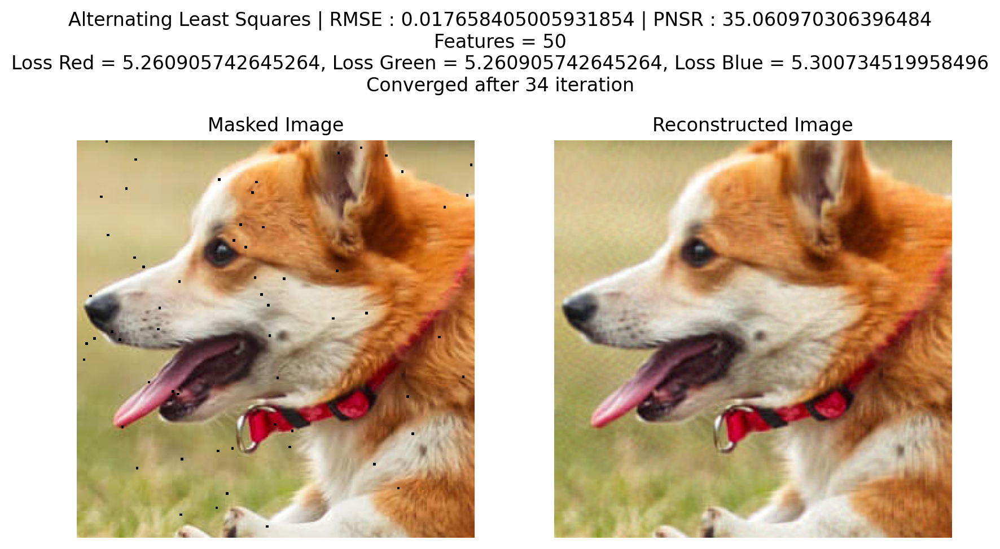

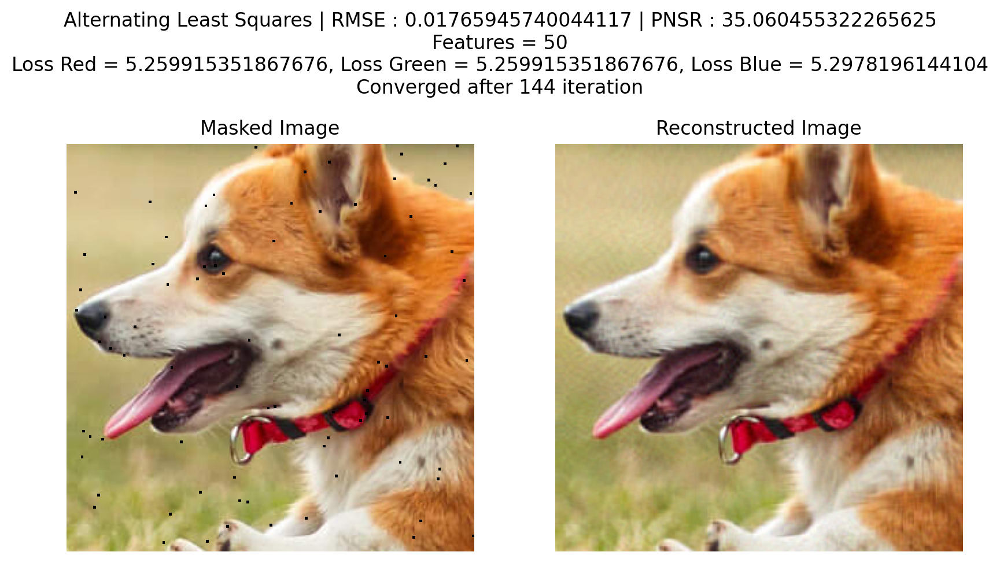

In [ ]:
features = 50
rmses_, psnrs_ = [], []
for i, patch_size in enumerate(patches):
    rmse, psnr = train_reconstruct_plot_subset(img_scaled, d = patch_size,features =  features, convergence = 1e-6, device = device, allowMetrics = True)
    rmses_.append(rmse)
    psnrs_.append(psnr)

Plots for Comparison

In [ ]:
rm = [x.detach().cpu().numpy() for x in rmses]
rm_ = [x.detach().cpu().numpy() for x in rmses_]

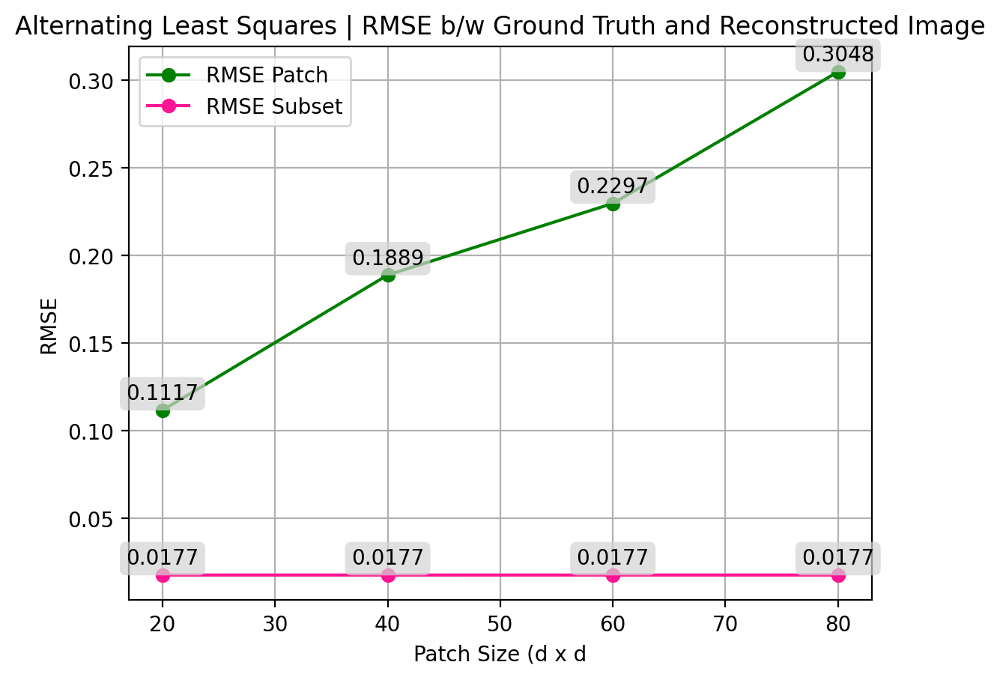

In [ ]:
plt.plot(patches, rm, marker = "o", label = "RMSE Patch", color = "green")
plt.plot(patches, rm_, marker = "o", label = "RMSE Subset", color = "deeppink")
plt.xlabel("Patch Size (d x d)")
plt.ylabel("RMSE")
plt.title("Alternating Least Squares | RMSE b/w Ground Truth and Reconstructed Image")
plt.grid()
plt.legend()
for i, psnr in enumerate(rm):
    plt.annotate(f'{psnr:.4f}', (patches[i], psnr), textcoords="offset points", xytext=(0, 5), ha="center",
                 bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='lightgray', alpha=0.7))

for i, psnr in enumerate(rm_):
    plt.annotate(f'{psnr:.4f}', (patches[i], psnr), textcoords="offset points", xytext=(0, 5), ha="center",
                 bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='lightgray', alpha=0.7))
plt.show()

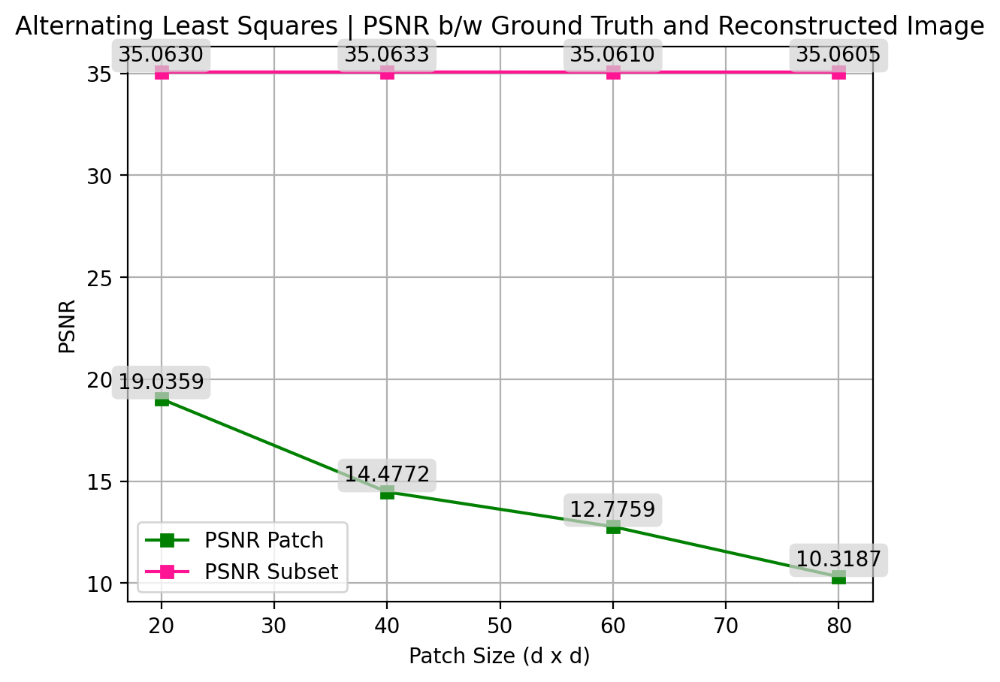

In [ ]:
plt.plot(patches, psnrs, marker = "s", label = "PSNR Patch", color = "green")
plt.plot(patches, psnrs_, marker = "s", label = "PSNR Subset", color = "deeppink")
plt.xlabel("Patch Size (d x d)")
plt.ylabel("PSNR")
plt.title("Alternating Least Squares | PSNR b/w Ground Truth and Reconstructed Image")
plt.grid()
plt.legend()
for i, psnr in enumerate(psnrs):
    plt.annotate(f'{psnr:.4f}', (patches[i], psnr), textcoords="offset points", xytext=(0, 5), ha="center",
                 bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='lightgray', alpha=0.7))
for i, psnr in enumerate(psnrs_):
    plt.annotate(f'{psnr:.4f}', (patches[i], psnr), textcoords="offset points", xytext=(0, 5), ha="center",
                 bbox=dict(boxstyle='round,pad=0.3', edgecolor='none', facecolor='lightgray', alpha=0.7))
plt.show()

Function to insert N points in the (d x d) patch

In [14]:
def insert_points(nums, img, corner, d, display = True):
  X, Y = corner
  new_img = img.clone()
  patch = torch.full_like(new_img[:, X : X + d, Y : Y + d], float("nan"))
  random_rows = np.random.randint(0, d, size = nums)
  random_cols = np.random.randint(0, d, size = nums)

  for row, col in zip(random_rows, random_cols):
    patch[:, row, col] = new_img[:, X + row, Y + col]

  new_img[:, X : X + d, Y : Y + d] = patch

  fig, ax = plt.subplots(nrows = 1, ncols = 2, gridspec_kw = {"width_ratios": [img.shape[2] / (5 * d), 1]})
  fig.suptitle(fr"$({X}, {Y})$ and patch size = $({d} \times {d})$ with {nums} points inside", fontsize = 13)
  ax[0].imshow(rearrange(new_img, 'c h w -> h w c').cpu().numpy())
  ax[0].set_title("Masked Image")
  ax[1].imshow(rearrange(img[:, X : X + d, Y : Y + d], 'c h w -> h w c').cpu().numpy())
  ax[1].set_title("Masked Crop")
  if (display):
      plt.show()
  else:
      plt.close()
  return new_img, img[:, X : X + d, Y : Y + d], nums/d**2

Daddy Function for EVERYTHING

In [15]:
def train_reconstruct(nums, epochs, img, Corner, d, features, convergence, device, display = True, displayAll = True, allowMetrics = False, allowSave = False, FileName = None):
  imgSingle, croppedSingle, frac = insert_points(nums, img, Corner, d, display)
  Ws, Hs, losses, FinalImage, i = factorize(imgSingle, features, epochs, convergence, device)
  img_copy = FinalImage.clone()
  X, Y = Corner
  newCroppedSingle = img_copy[:, X : X + d, Y : Y + d]
  rmse, psnr = metrics(img, img_copy)
  # latexify(columns = 2)
  if (displayAll):
    fig, ax = plt.subplots(nrows = 1, ncols = 3, gridspec_kw = {"width_ratios": [img.shape[2] / (3 * d), 1, img.shape[2] / (3 * d)]}, figsize = (15, 8))
    fig.suptitle(f"Alternating Least Squares: RMSE : {rmse} | PNSR : {psnr}" "\n" fr"Crop Corner = $({X}, {Y})$" "\n" f"Features = {features}" "\n" fr"Loss Red = {losses[0]}, Loss Green = {losses[0]}, Loss Blue = {losses[2]}" "\n" f"Converged after {i} iteration", fontsize = 12)
    ax[0].imshow(rearrange(imgSingle, 'c h w -> h w c').cpu().numpy())
    ax[0].set_title("Masked Image" "\n" rf"$({img.shape[1]} \times {img.shape[2]})$")
    ax[1].imshow(rearrange(croppedSingle, 'c h w -> h w c').cpu().numpy())
    ax[1].set_title("Patch" "\n" fr"$({d} \times {d})$")
    ax[2].imshow(rearrange(FinalImage, 'c h w -> h w c').cpu().detach().numpy())
    ax[2].set_title("Reconstructed Image" "\n" rf"$({img.shape[1]} \times {img.shape[2]})$")
  if (allowSave):
      # FinalImage = F.normalize(FinalImage, 0, 1)
      FinalImage = (FinalImage - FinalImage.min()) / (FinalImage.max() - FinalImage.min())
      FinalImage = torch.clamp(FinalImage, 0, 1)
      imsave(f"{FileName}.png", rearrange(FinalImage, 'c h w -> h w c').cpu().detach().numpy())

  if (displayAll):
    for i in range(3):
        ax[i].axis("off")
    plt.show()

  if (displayAll):
    fig, ax = plt.subplots(nrows = 1, ncols = 2, gridspec_kw = {"width_ratios": [1, 1]}, figsize = (8, 4))
    fig.suptitle("Comparison of Original and Reconstructed Patch", fontsize = 12)
    ax[0].imshow(rearrange(croppedSingle, 'c h w -> h w c').cpu().numpy())
    ax[0].set_title("Original Patch")
    ax[0].axis("off")
    ax[1].imshow(rearrange(newCroppedSingle, 'c h w -> h w c').cpu().detach().numpy())
    ax[1].set_title("Reconstructed Patch")
    ax[1].axis("off")
    plt.show()

  if (allowMetrics):
      return rmse, psnr, frac

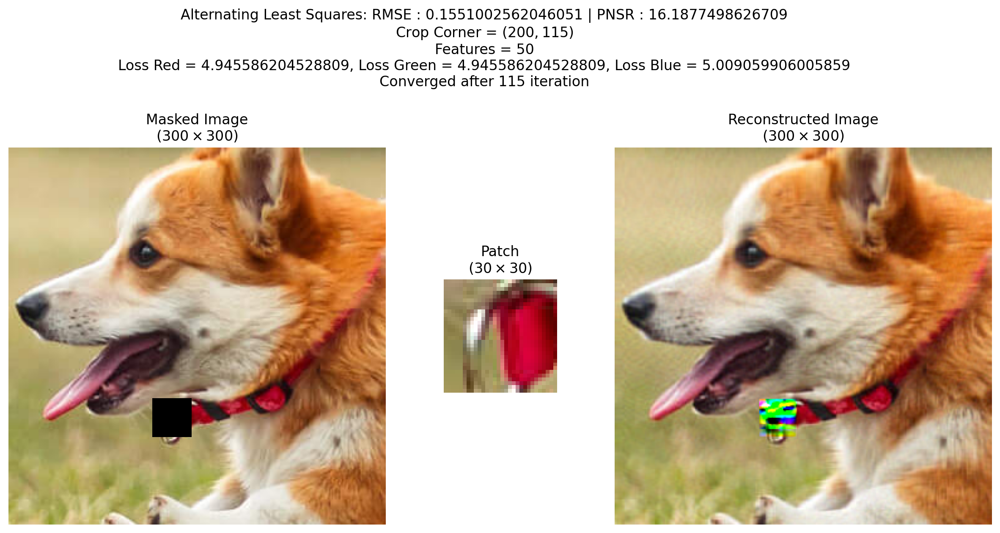

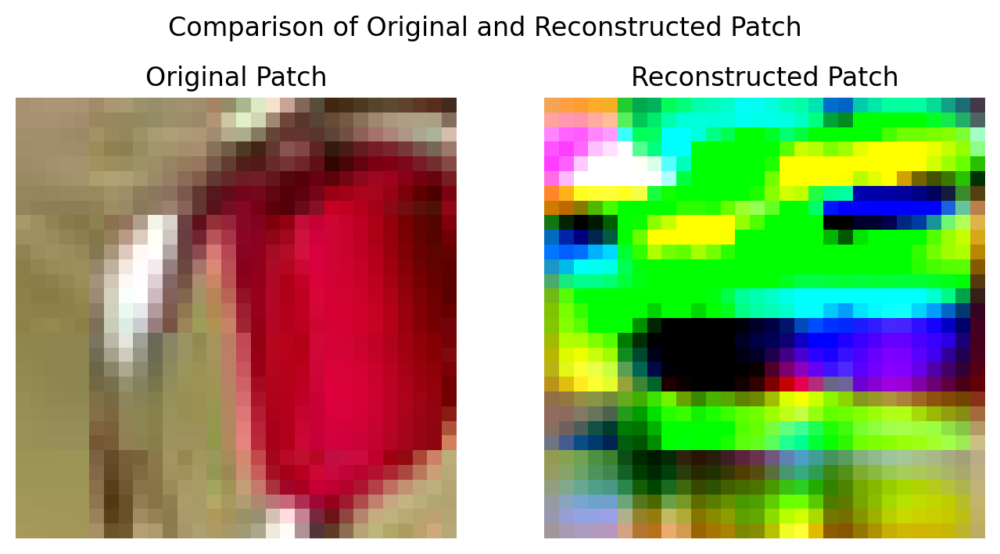

In [16]:
train_reconstruct(nums=0, epochs=1000, img=img_scaled, Corner = (200,115), d=30, features=50, convergence=1e-5, device=device, display = False)

(30 x 30) frame with Single Color

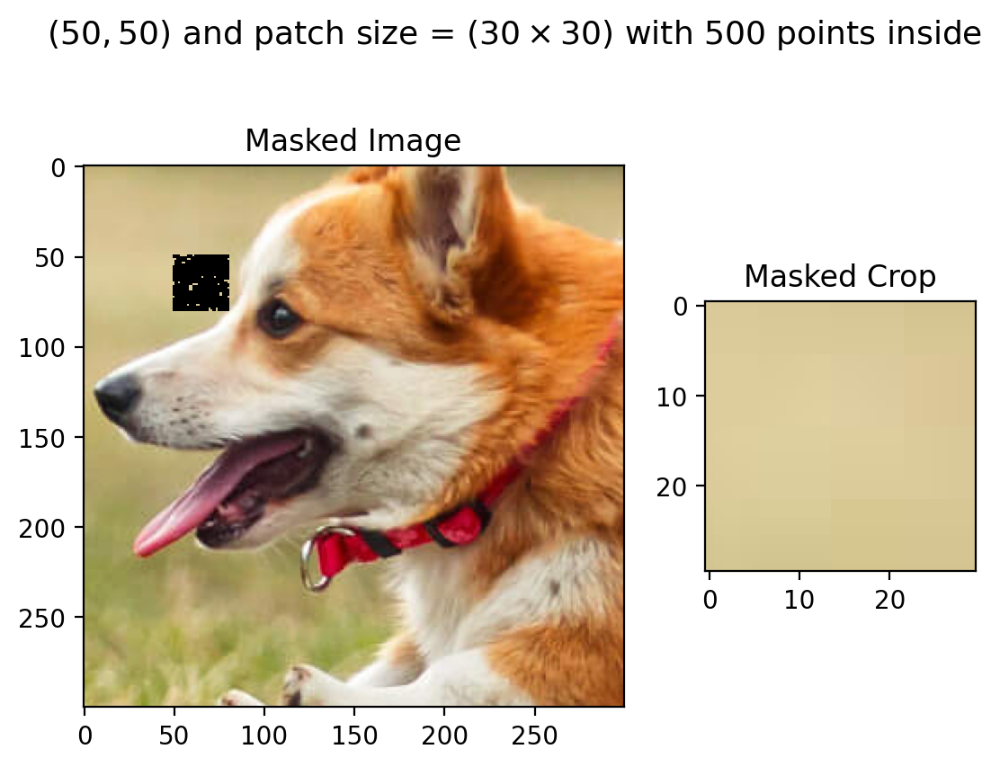

In [17]:
imgSingle30, croppedSingle30, _ = insert_points(500, img_scaled, (50, 50), 30)

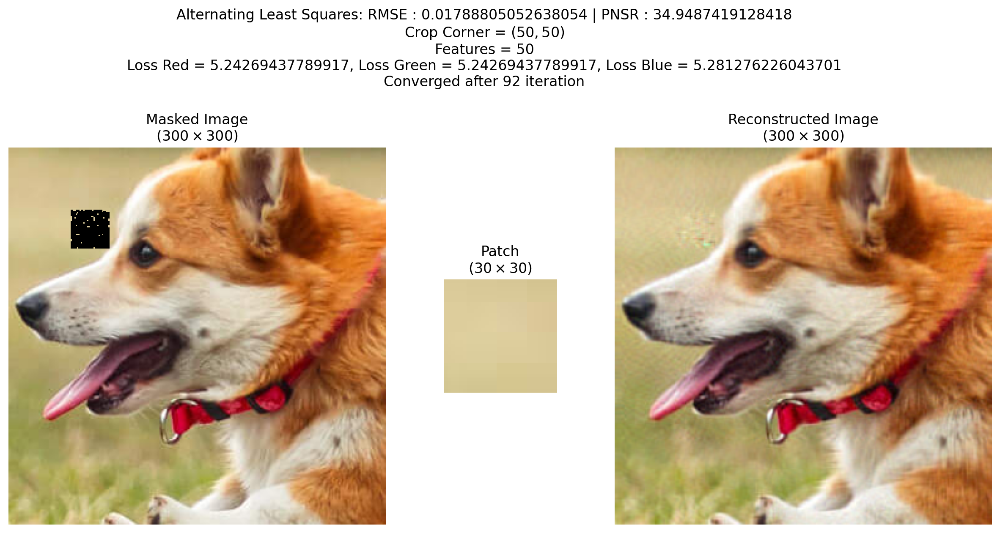

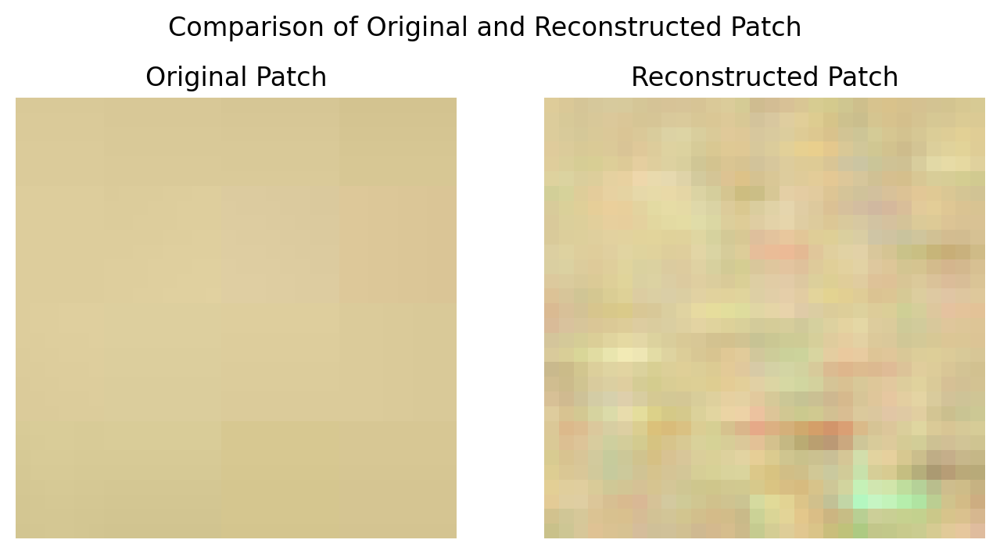

In [18]:
features, nums, epochs, convergence = 50, 500, 10000, 1e-6
train_reconstruct(nums, epochs, img_scaled, (50, 50), 30, features, convergence, device, display = False)

(30 x 30) frame with 2-3 Colors

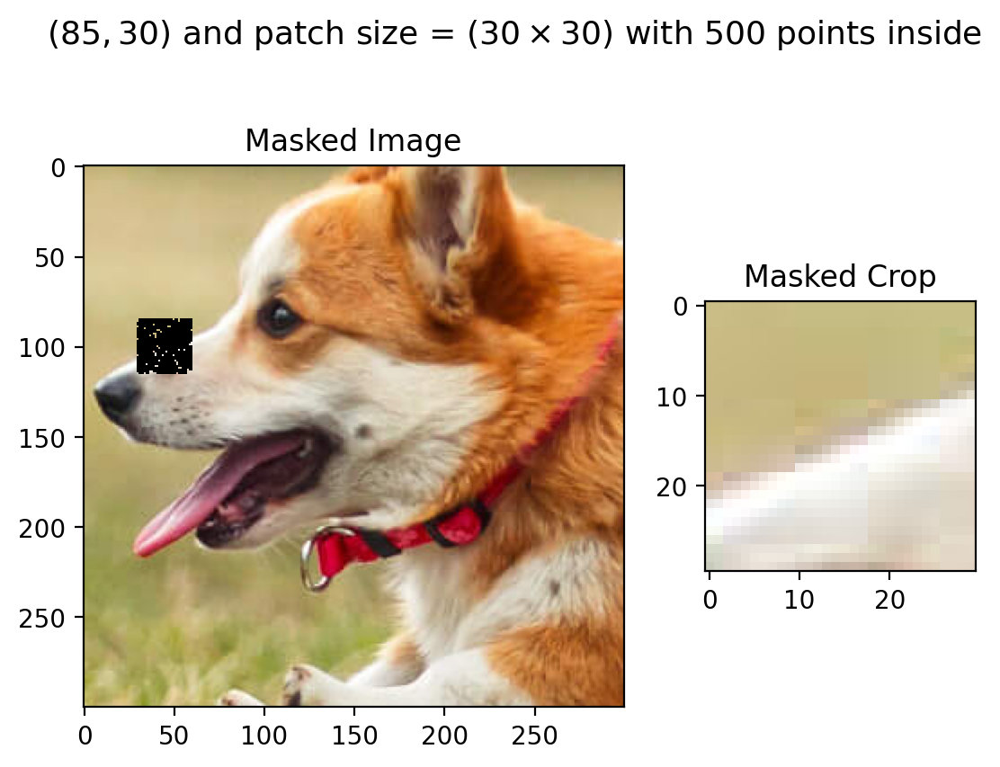

In [16]:
imgDouble30, croppedDouble30, _ = insert_points(500, img_scaled, (85, 30), 30)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


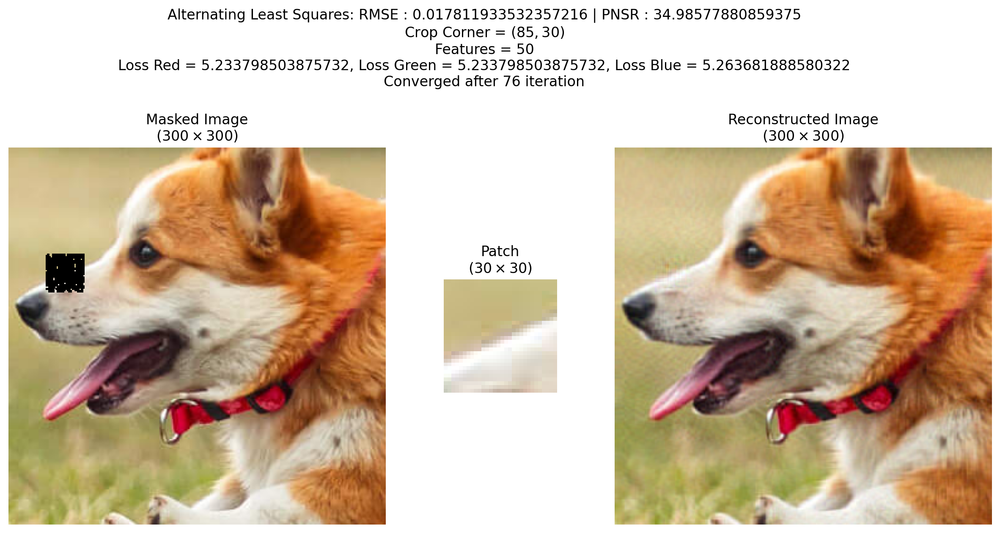

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


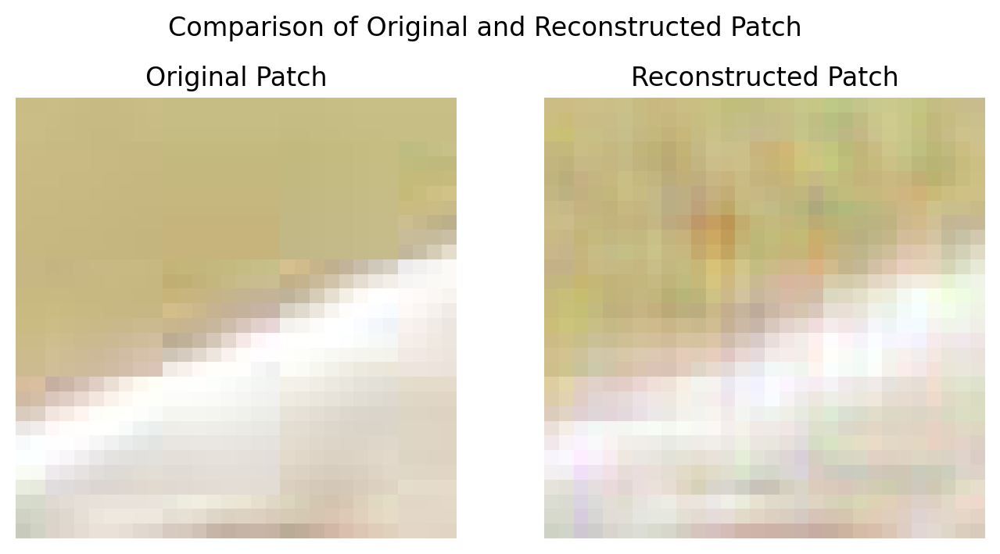

In [17]:
features, nums, epochs, convergence = 50, 500, 10000, 1e-6
train_reconstruct(nums, epochs, img_scaled, (85, 30), 30, features, convergence, device, display = False)

30 x 30 frame with atleast 5 Colors

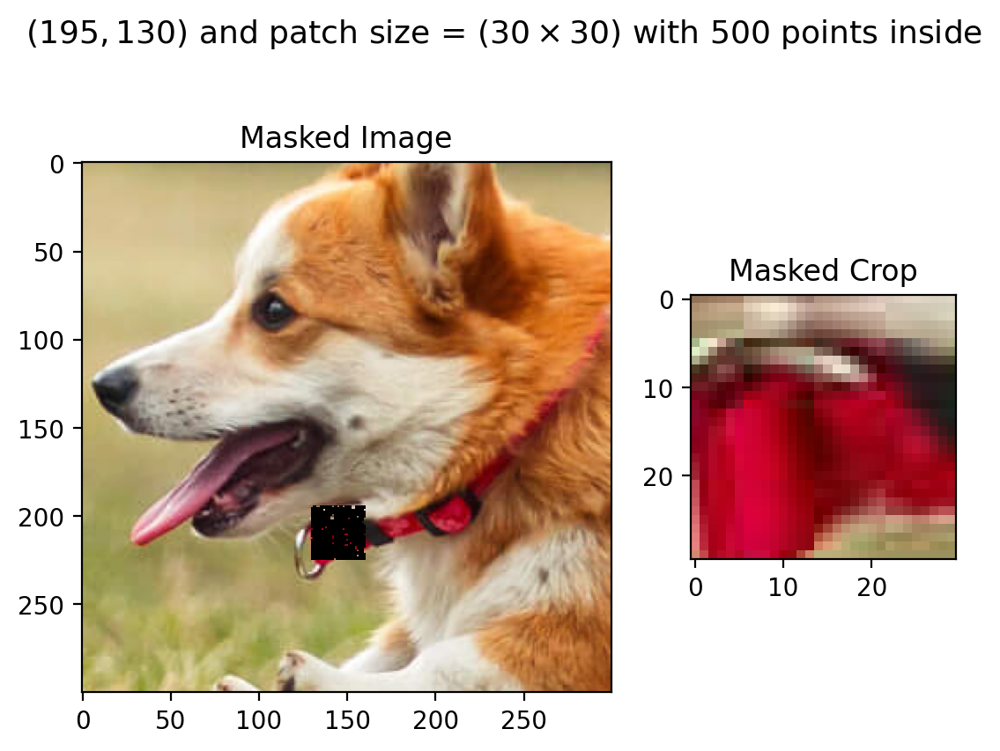

In [18]:
imgMulti30, croppedMulti30, _  = insert_points(500, img_scaled, (195, 130), 30)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


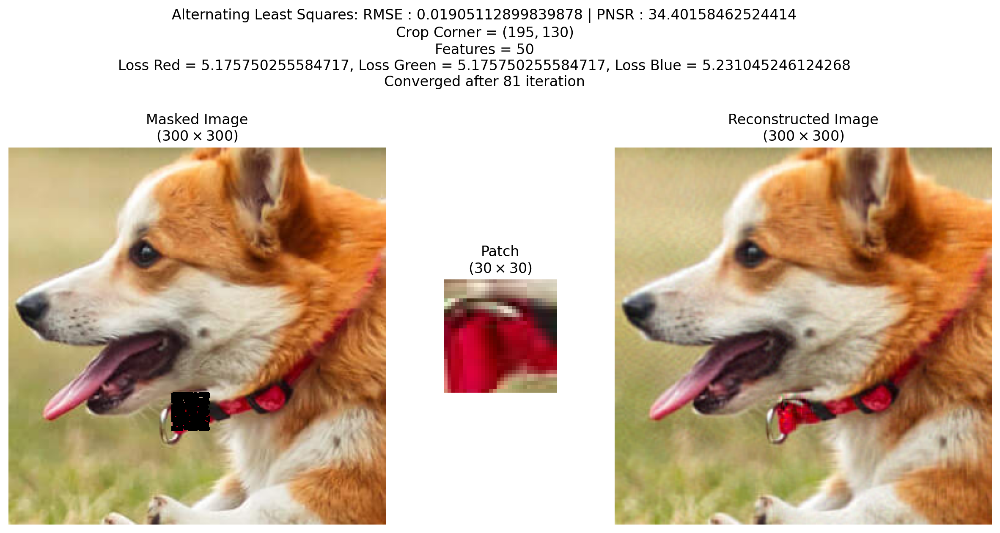

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


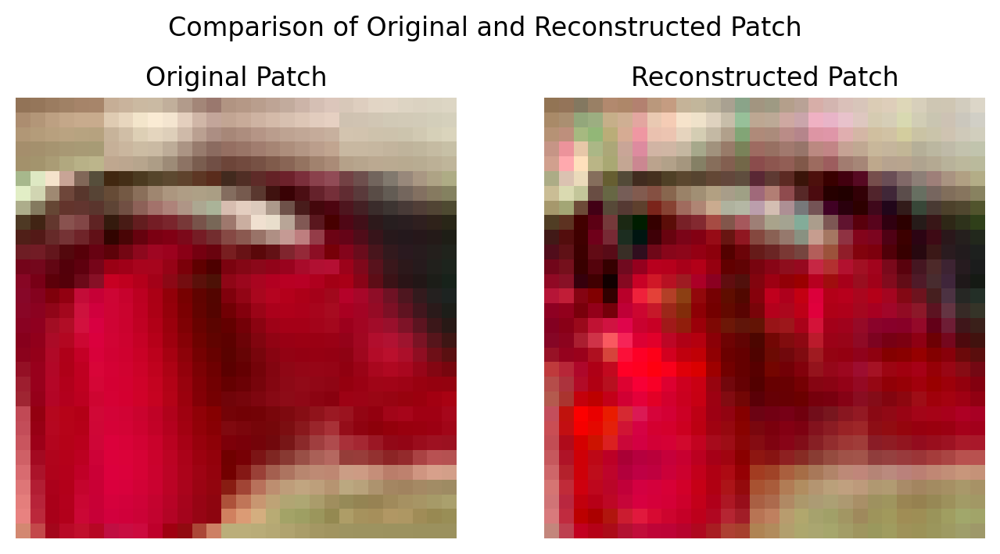

In [19]:
features, nums, epochs, convergence = 50, 500, 10000, 1e-6
train_reconstruct(nums, epochs, img_scaled, (195, 130), 30, features, convergence, device, display = False)